# An Exploration of US public health data 

This project is an excercise in data analysis where a dataset focused on public health for the US with resolution at the county level is explored and a model for predicting obesity levels is trained. This is a personal learning project with no pretense at drawing causations or conclusions.

- Correlation Matrix
- Plotting of correlated columns
- Maps
- Watershed Analysis
- Hotspot Analysis
- Machine Learning Models
---

**Loading and preparing data for US**

Source: County Health Rankings & Roadmap, a project by the University of Wisconsin

The original file was edited in Excel to keep only the relevant columns and to allow for easier editing in Pandas.

Columns are:

- % Adults with Obesity (Percentage of the adult population that reports a body mass index (BMI) greater than or equal to 30 kg/m2 - same definition as in the EU dataset)
- % Physically Inactive
- % Excessive Drinking 
- Food Environment Index (Access to healthy foods by considering the distance an individual lives from a grocery store or supermarket, locations for health food purchases in most communities, and the inability to access healthy food because of cost barriers)
- % Fair or Poor Health
- Income Ratio (Ratio of household income at the 80th percentile to income at the 20th percentile; higher means higher inequality)
- Life Expectancy
- Median Household Income 
- Gender Pay Gap (Ratio of women's median earnings to men's median earnings; 1 is equal pay)
- % Some College
- Water Violation (Indicator of the presence of health-related drinking water violations)

In [7]:
# Core data libraries
import pandas as pd
import numpy as np
import geopandas as gpd

# Visualization
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots
import seaborn as sns
import matplotlib.pyplot as plt
import kaleido

# Statistics & spatial analysis
from scipy import stats
from scipy.stats import pearsonr
from libpysal.weights import Queen
from esda.getisord import G_Local
from esda.moran import Moran_Local
from shapely.geometry import Point

# ML models & metrics
from sklearn.model_selection import (train_test_split, cross_val_score, KFold,GridSearchCV)
from sklearn.metrics import (mean_absolute_error, mean_squared_error, r2_score)
from sklearn.linear_model import (LinearRegression, Ridge, ElasticNet)
from sklearn.ensemble import (RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor)
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from skopt import BayesSearchCV
from skopt.space import Real, Integer

# Settings
%matplotlib inline
import warnings
import logging
pio.renderers.default = 'notebook'
pd.set_option('display.float_format', lambda x: '%.5f' % x)
warnings.filterwarnings('ignore')
logging.getLogger('lightgbm').setLevel(logging.WARNING)

In [8]:
# Load database
df=pd.read_excel("US Data.xlsx")
df["FIPS"]=df["FIPS"].fillna(0).astype(int).astype(str).str.zfill(5)
# Load data for upstream population computed from code in https://github.com/luizedu91/watersheds/blob/main/watershed.ipynb 
df_watershed=gpd.read_file('counties_with_upstream_data.gpkg', engine= 'pyogrio', use_arrow=True)[['FIPS','POPULATION',"upstream_area","upstream_population"]]
df=df.merge(df_watershed, on=['FIPS'], how='left')

In [9]:
# Load file with county geometry data
counties_geo = gpd.read_file('cb_2023_us_all_500k.gdb', layer= 'cb_2023_us_county_500k', engine= 'pyogrio', use_arrow= True)[['GEOID','ALAND','geometry']].rename(columns={"GEOID":"FIPS"})

# Fill missing geo data for CT (database uses deprecated counties format for the state)
connecticut= gpd.read_file('Connecticut/cb_2019_09_bg_500k.shp', engine= 'pyogrio', use_arrow= True)[['STATEFP','COUNTYFP',"geometry"]]
connecticut["FIPS"]=connecticut[['STATEFP','COUNTYFP']].agg(''.join, axis=1)
connecticut.drop(['STATEFP','COUNTYFP'], axis=1,inplace=True)
connecticut = connecticut.dissolve(by="FIPS").reset_index()

# Concat both geo dataframes
counties_geo= pd.concat([counties_geo, connecticut])

# Merge to final dataframe and clean data
df = df[df["FIPS"].notnull()]
df["FIPS"] = df["FIPS"].astype(str).str.zfill(5)
df = df.merge(counties_geo, on=['FIPS'], how='left')
df = gpd.GeoDataFrame(df, geometry="geometry")
df = df[df.geometry.notnull()]
df['geometry'] = df.to_crs(df.estimate_utm_crs()).simplify(10000).to_crs(df.crs)

# Convert to GeoJSON format for Plotly
counties_json = df.__geo_interface__

**Air Contamination Data**

In [10]:
# Add air quality information
air=pd.read_csv('annual_aqi_by_county_2024.csv')
air['Air Quality: % Bad Days'] = (air['Unhealthy for Sensitive Groups Days'] + air['Unhealthy Days'] + air['Very Unhealthy Days'] + air['Hazardous Days'])*100/ air['Days with AQI'] 
air['Air Quality: % High Pollutant Days'] =(air['Days Ozone']+air['Days PM10']+air['Days CO']+air['Days NO2']+air['Days Ozone']+air['Days PM2.5']) *100 / air['Days with AQI'] # Measure may sum to more than 1.0
air.drop(columns=['Year', 'Days with AQI', 'Good Days', 'Moderate Days', 'Unhealthy for Sensitive Groups Days', 'Unhealthy Days', 'Very Unhealthy Days', 'Hazardous Days', 'Max AQI', '90th Percentile AQI', 'Median AQI', 'Days PM10', 'Days CO', 'Days NO2', 'Days Ozone', 'Days PM2.5'], axis=1, inplace=True)
df=pd.merge(df, air, on=['State', 'County'], how='left')

**Water Contamination Data**

Resulting column will contain the number of occurences of high level of some contaminant

In [11]:
water = pd.read_csv('SDWA_VIOLATIONS_ENFORCEMENT.csv', usecols=['PWSID', 'CONTAMINANT_CODE'], dtype = {'PWSID': str, 'CONTAMINANT_CODE': str})
water_codes = pd.read_csv('SDWA_REF_CODE_VALUES.csv', usecols=['VALUE_CODE','VALUE_DESCRIPTION'], dtype = {'VALUE_CODE': str, 'VALUE_DESCRIPTION': str})

# Merge datasets to include contaminant names, not only codes
water=pd.merge(water, water_codes, left_on='CONTAMINANT_CODE', right_on='VALUE_CODE', how='left')
# Group by source and type of contamination
water = water.groupby(['PWSID', 'VALUE_DESCRIPTION']).size().reset_index(name='Infraction_Count')
# Merge with another dataset to include ZIP codes for each row
water_merged = pd.merge(water, pd.read_csv('SDWA_PUB_WATER_SYSTEMS.csv', usecols=['PWSID', 'ZIP_CODE']), on='PWSID', how='left')

In [12]:
# Clean ZIP codes
def five_digits(zip_code):
    if isinstance(zip_code, str) and len(zip_code) > 5:
        return zip_code[0:5]
    return zip_code

water_merged['ZIP_CODE']=water_merged['ZIP_CODE'].apply(five_digits)

# Merge according to ZIP codes in order to have FIPS codes
zip=pd.read_csv('ZIP-COUNTY-FIPS_2017-06.csv', usecols=['ZIP', 'STCOUNTYFP'], dtype={'ZIP':str, 'STCOUNTYFP': str})
water_merged=pd.merge(water_merged, zip, left_on="ZIP_CODE", right_on='ZIP', how='left')
water_merged.drop(columns=['PWSID','ZIP_CODE','ZIP'], inplace=True)

# Pivot so each row is one county
water_merged_pivot = water_merged.pivot_table(index='STCOUNTYFP', columns='VALUE_DESCRIPTION', values='Infraction_Count', aggfunc='sum', fill_value=0).reset_index()

In [13]:
# Categorize contaminants and clean dataset
categories = {
    "Water Contaminants: Inorganic": [
        "Lead", "COPPER, FREE", "Chromium", "Selenium", "Barium", "Cadmium", "Mercury", "Nickel", 'Beryllium, Total', "Antimony, Total", "Thallium, Total", "Fluoride", "Nitrite", "Nitrate-Nitrite", "CYANIDE", "Chlorite", "Bromate", "Chlorine dioxide","Arsenic", "Silver", "Sulfate"
    ],
    "Water Contaminants: Organic": [
        "Trichloroethylene", "Benzene", "1,1-Dichloroethylene", "Carbon tetrachloride", "1,1,1-Trichloroethane", "p-Dichlorobenzene", "1,2-Dichloroethane", "Tetrachloroethylene", "Toluene", "Ethylbenzene", "Xylenes, Total", "Vinyl chloride", "DICHLOROMETHANE", "cis-1,2-Dichloroethylene", "trans-1,2-Dichloroethylene", "Pentachlorophenol", "Di(2-ethylhexyl) phthalate", "HEXACHLOROBENZENE", "Hexachlorocyclopentadiene", "1,2,4-Trichlorobenzene", "Benzo(a)pyrene", "Atrazine", "Simazine", "Toxaphene", "Methoxychlor", "2,4-D", "2,4,5-TP","Carbofuran", "Glyphosate", "Aldicarb", "Aldicarb sulfoxide", "Aldicarb sulfone", "Endrin", "Heptachlor", "Heptachlor epoxide", "Picloram", "Diquat", "Endothall", "OXAMYL", "Dinoseb","1,1,1,2-Tetrachloroethane", "1,1,2,2-Tetrachloroethane", "1,1,2-Trichloroethane", "1,1-Dichloroethane", "1,1-Dichloropropene", "1,2,3-Trichloropropane", "1,2-Dichloropropane", "1,3-DICHLOROPROPENE", "1,3-Dichloropropane", "2,2-Dichloropropane", "Acrylamide", "Aldrin", "Aroclor 1016", "Aroclor 1221", "Aroclor 1232", "Aroclor 1242", "Aroclor 1248", "Aroclor 1254", "Aroclor 1260", "BHC-GAMMA", "Bis(2-ethylhexyl) phthalate", "Bromobenzene", "Bromodichloromethane", "Bromoform", "Bromomethane", "Butachlor", "CHLOROBENZENE", "Carbaryl", "Chlordane", "Chloroethane", "Chloroform", "Chloromethane", "Dalapon", "Di(2-ethylhexyl) adipate", "Dibromochloromethane", "Dibromomethane", "Dicamba", "Dieldrin", "Epichlorohydrin", "METHYL TERT-BUTYL ETHER", "Methomyl", "Metolachlor", "Metribuzin", "Propachlor", "Styrene", "m-Dichlorobenzene", "m-Xylene", "o-Chlorotoluene", "o-Dichlorobenzene", "o-Xylene", "p-Chlorotoluene", "p-Xylene"
    ],
    "Water Contaminants: Microbiological": [
        "E. COLI", "Cryptosporidium", "Coliform (Pre-TCR)", "COLIPHAGE", "Turbidity", "ENTEROCOCCI", "Fecal Coliform"
    ],
    "Water Contaminants: Other": [
        "Chlorine", "Asbestos", "CARBON, TOTAL", "ETHYLENE DIBROMIDE", "1,2-DIBROMO-3-CHLOROPROPANE", "Total Polychlorinated Biphenyls (PCB)", "3-Hydroxycarbofuran", "3-Nitroaniline", "Residual Chlorine", "2,3,7,8-TCDD", "LASSO", "Total Haloacetic Acids (HAA5)", "TTHM", "Bromate", "Chloramine","Gross Alpha, Excl. Radon and U", "Gross Beta Particle Activity", "Tritium", "38-STRONTIUM-90", "53-IODINE-131", "ManMade Beta Particle and Photon Emitter", "Combined Uranium", "Radium-226", "Radium-228", "Combined Radium (-226 and -228)"
    ],
}

to_drop=['Coliform (TCR)', 'Native American Tribe', 'Not applicable', 'SCALE NOT APPLICABLE TO COLLECTION METHOD', 'Unknown Agency Type', 'Unknown Area Type', 'Surface Water Treatment Rule','Consumer Confidence Rule', "Filter Backwash Rule", 'Unknown Enforcement Action Type', 'Public Notice', 'Unknown Tribe','Revised Total Coliform Rule', 'Nitrate', "Lead and Copper Rule", "Stage 1 Disinfectants and Disinfection Byproducts Rule", "Stage 2 Disinfectants and Disinfection Byproducts Rule", "Interim Enhanced Surface Water Treatment Rule", "Long Term 2 Enhanced Surface Water Treatment Rule", "Groundwater Rule"]

for category, cols in categories.items():
    water_merged_pivot[category] = water_merged_pivot[cols].sum(axis=1)
    
columns_to_drop = [column for category in categories.values() for column in category] + to_drop

water_merged_pivot.drop(columns=[columns for columns in columns_to_drop], inplace=True)

# Merge to original dataframe
df=pd.merge(df,water_merged_pivot, left_on="FIPS", right_on="STCOUNTYFP", how='left')
df.drop(columns=['STCOUNTYFP'], inplace=True)
df.rename(columns={'POPULATION':'Population', 'upstream_area':"Upstream Area", 'upstream_population':"Upstream Population", 'ALAND':"Area"}, inplace=True)

# Saving df to load more easily when exported
#df.to_parquet("Public_Health.parquet")

---
# 1. Socioeconomic Relationships

## 1.1 Exploratory Data Analysis

In [8]:
df[['% Adults with Obesity', '% Physically Inactive', '% Excessive Drinking','Food Environment Index', '% Fair or Poor Health', 'Income Ratio', 'Life Expectancy', 'Median Household Income', 'Gender Pay Gap','% Some College','Air Quality: % Bad Days', 'Air Quality: % High Pollutant Days', 'Water Contaminants: Inorganic', 'Water Contaminants: Organic','Water Contaminants: Microbiological', 'Water Contaminants: Other']].describe().loc[['count', 'mean', 'std', 'min', 'max']]

,% Adults with Obesity,% Physically Inactive,% Excessive Drinking,Food Environment Index,% Fair or Poor Health,Income Ratio,Life Expectancy,Median Household Income,Gender Pay Gap,% Some College,Air Quality: % Bad Days,Air Quality: % High Pollutant Days,Water Contaminants: Inorganic,Water Contaminants: Organic,Water Contaminants: Microbiological,Water Contaminants: Other
count,3143.00000,3143.00000,3143.00000,3108.00000,3143.00000,3128.00000,3070.00000,3142.00000,3137.00000,3137.00000,960.00000,960.00000,3138.00000,3138.00000,3138.00000,3138.00000
mean,37.35221,26.66258,16.86739,7.54305,17.72603,4.55036,75.75492,63267.72470,0.78148,58.87165,0.99144,154.29668,518.63448,1874.89930,55.51179,941.20268
std,4.55862,5.23175,2.62241,1.19756,4.54661,0.80724,3.43361,16275.49141,0.10311,11.85110,3.11262,36.69193,1177.06721,4493.47872,129.46044,2347.42923
min,17.40000,12.00000,9.03810,0.00000,8.40000,1.65164,55.91896,28972.00000,0.25873,11.76471,0.00000,100.00000,0.00000,0.00000,0.00000,0.00000
max,52.50000,47.00000,26.79776,10.00000,38.00000,10.53234,98.90294,167605.00000,1.72807,100.00000,40.00000,200.00000,28674.00000,66094.00000,1909.00000,28344.00000


---
- Apart from the air quality dataset, the data is quite complete, with little difference in Count between columns
- There is significant variation in every measure within the country. 
- - Life expectancy ranges from 56 (equivalent to Chad or Lesotho) to 99 (higher than the highest national average,  Japan - 85)
- - College education ranges from 11% to 100%
- - Income ranges from USD 29k to USD 167k
- - Obesity ranges from 17% to 52%
---

## 1.2 Correlation Analysis

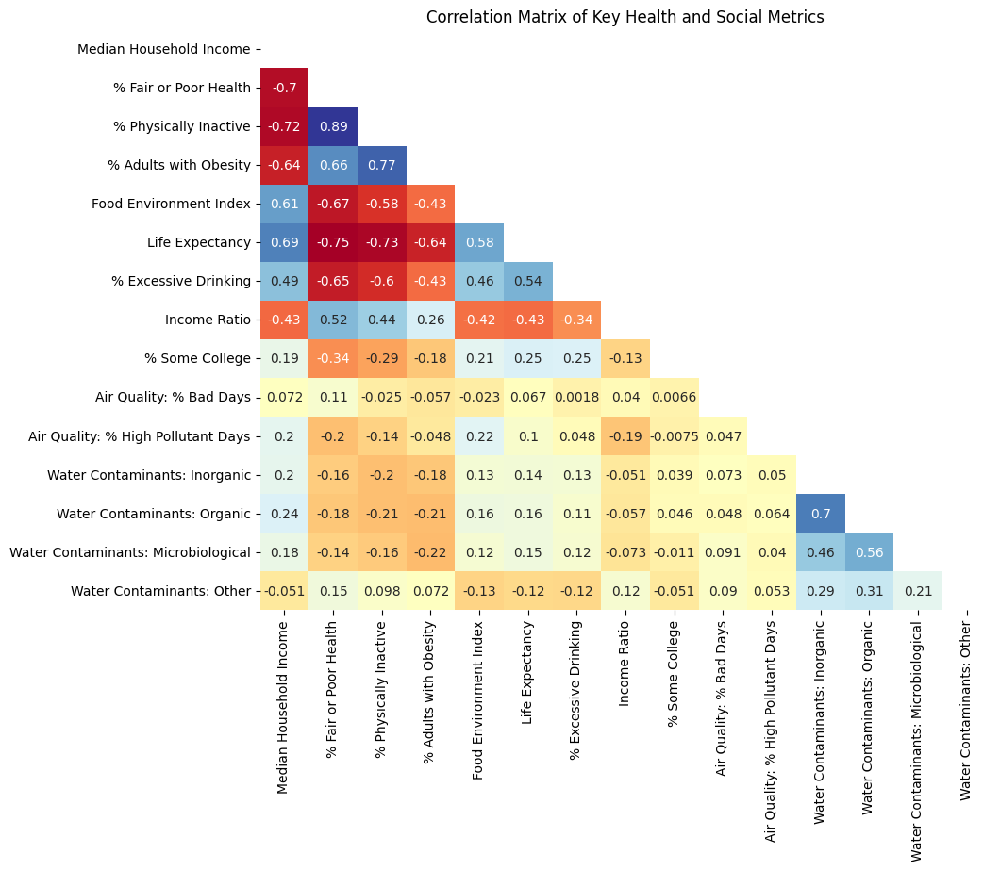

In [9]:
# Correlation Matrix
corr=df[['Median Household Income', '% Fair or Poor Health', '% Physically Inactive','% Adults with Obesity','Food Environment Index','Life Expectancy','% Excessive Drinking','Income Ratio','% Some College', 'Air Quality: % Bad Days', 'Air Quality: % High Pollutant Days', 'Water Contaminants: Inorganic','Water Contaminants: Organic', 'Water Contaminants: Microbiological', 'Water Contaminants: Other']].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr,
            annot=True,
            cmap='RdYlBu',
            mask=np.triu(np.ones_like(corr, dtype=bool)),
            cbar=False)
plt.title('Correlation Matrix of Key Health and Social Metrics');

---
Insights from the correlation matrix

Strong correlations:

1. Lower income - poor health - physical inactivity - obesity

2. Food Environment Index - higher income - better health metrics

3. Shorter life expectancies - poor health at present - inactivity - obesity - lower income - less access to fresh food - less education - excessive drinking

Moderate correlations:

1. Education - improvement in all metrics

2. Higher inequality - worse in all metrics

There was no relevant correlations between gender pay gap or water violations and any public health metrics and therefore they were dropped from the graph for better visualization. Another indication that water quality has little influence on the measured health outcomes.

This suggests socioeconomic status significantly impacts health outcomes, with physical inactivity being a key mediating factor.

---

## 1.3 Plots for significant correlations

In [10]:
# Interactive Bubble Plot using Plotly
fig = px.scatter(df.dropna(subset= ['Median Household Income','% Fair or Poor Health','% Adults with Obesity','Food Environment Index','County','% Physically Inactive']),
                 x='Median Household Income',
                 y='% Fair or Poor Health',
                 size='% Adults with Obesity',
                 color='% Physically Inactive',
                 color_continuous_scale="RdYlBu_r",
                 hover_data=['County', 'State', 'Food Environment Index'],
                 title='Poor Health vs. Income, Color by Inactivity, Size by Obesity')

fig.update_traces(marker=dict(sizeref=0.06))
fig.show()

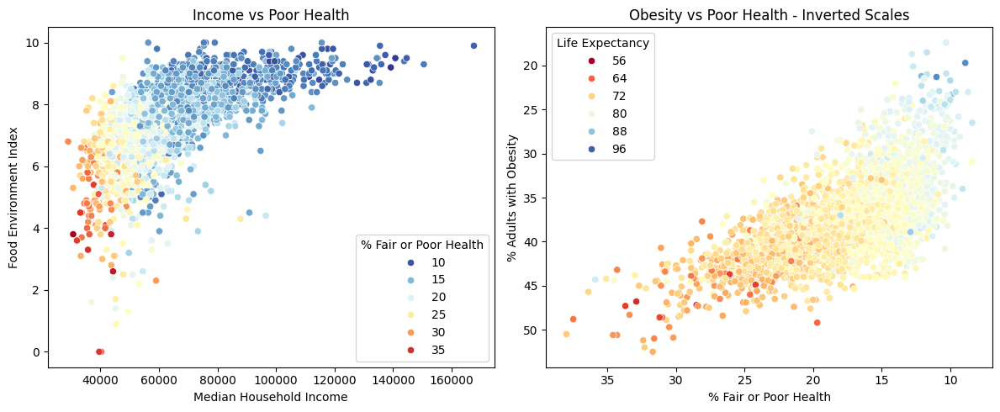

In [11]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

# Plot 1
sns.scatterplot(data=df,
                x='Median Household Income',
                y='Food Environment Index',
                hue='% Fair or Poor Health',
                ax=axes[0],
                palette='RdYlBu_r',
                hue_norm=(df['% Fair or Poor Health'].min(), df['% Fair or Poor Health'].max()))
axes[0].set_title('Income vs Poor Health')

# Plot 2
sns.scatterplot(data=df,
                y='% Adults with Obesity' ,
                x='% Fair or Poor Health',
                hue='Life Expectancy',
                palette='RdYlBu',
                ax=axes[1])
axes[1].set_title('Obesity vs Poor Health - Inverted Scales')
axes[1].invert_yaxis()
axes[1].invert_xaxis()

plt.tight_layout()
plt.show()

---
Lower income counties have lower accessibility to fresh produce, both of which go hand in hand with higher obesity and poorer health.

# 2. Geographic Relationships

## 2.1 US Maps

Median Income

In [47]:
# Median Household Income Map
fig = px.choropleth_mapbox(
    df,
    geojson=counties_json,
    locations=df.index,
    color='Median Household Income', 
    color_continuous_scale="Turbo",
    mapbox_style="open-street-map",
    hover_data=['County', 'State'],
    center={"lat": 39.5, "lon": -93.5},
    opacity=0.7,
    labels={'County':"County", 'Median Household Income': 'Median Household Income'},
)

# Update layout
fig.update_layout(
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox=dict(
        zoom=3
    ),
    height=400)

Life Expectancy

In [49]:
# Life Expectancy Map
fig = px.choropleth_mapbox(
    df,
    geojson=counties_json,
    locations=df.index,
    color='Life Expectancy', 
    color_continuous_scale="Turbo",
    mapbox_style="open-street-map",
    hover_data=['County', 'State'],
    center={"lat": 39.5, "lon": -93.5},
    opacity=0.7,
    labels={'County':"County", 'Life Expectancy': 'Life Expectancy'},
    title = 'Life Expectancy'
)

# Update layout
fig.update_layout(
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox=dict(
        zoom=3
    ),
    height=400)

Obesity

In [50]:
# Obesity map
fig = px.choropleth_mapbox(
    df,
    geojson=counties_json,
    locations=df.index,
    color='% Adults with Obesity',
    color_continuous_scale="Turbo",
    mapbox_style="open-street-map",
    hover_data=['County', 'State'],
    center={"lat": 39.5, "lon": -93.5},
    opacity=0.7,
    labels={'County':"County", '% Adults with Obesity': '% Adults with Obesity'}
)

# Update layout
fig.update_layout(
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox=dict(
        zoom=3
    ),
    height=400)

## 2.2 Watershed analysis

There appears to be some correlation between the lower Mississippi watershed and higher obesity downstream. One hypothesis is that the pollution from population and agricultural and industrial activity accumulates and affectis the health of populations downstream disproportionatelly in comparison to populations upstream.

![alt text](<Watershed (2)-2.jpg>)

---

In [51]:
# Filter outliers on Upstream Population due to calculation errors to improve readability of the color scale
upper_bound = df['Upstream Population'].quantile(0.99)
df.loc[df['Upstream Population'] > upper_bound, 'Upstream Population'] = 0
df['Upstream Population']=df['Upstream Population'].fillna(0)

In [54]:
df['Upstream Population'].fillna(0, inplace=True) 

# Create choropleth map for upstream population
fig = px.choropleth_mapbox(
    df,
    geojson=counties_json,
    locations=df.index,
    color='Upstream Population', 
    color_continuous_scale="Turbo",
    mapbox_style="open-street-map",
    hover_data=['County', 'State'],
    center={"lat": 39.5, "lon": -93.5},
    opacity=0.7,
    labels={'Upstream Population': 'Upstream Population'}
)

# Update layout
fig.update_layout(
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox=dict(
        zoom=3,
        style="open-street-map"),
    height=400)

In [56]:
# Correlations between the calculated upstream population 
corr=df[['Upstream Population', "% Adults with Obesity"]].corr()['Upstream Population']['% Adults with Obesity']
print(f"Correlation with obesity: {corr:.3f}")
corr=df[['Upstream Population', "% Fair or Poor Health"]].corr()['Upstream Population']['% Fair or Poor Health']
print(f"Correlation with poor health: {corr:.3f}")

Correlation with obesity: -0.094
Correlation with poor health: 0.002


---
Irrelevant correlation. 

Attempt at correlating only the Mississippi watershed

---

In [57]:
# Create mask only for the Mississippi watershed
from shapely.geometry import Polygon

# Approximate bounding box for Mississippi watershed
coords = [(-92.5, 29.0),  # Bottom west
        (-115, 55),  # Top west
        (-83, 55),  # Top east
        (-90, 29.0),  # Bottom east
        (-95.5, 29.0)]   # Close polygon
boundary = Polygon(coords)

# Filter counties that intersect with the bounding box
mississippi_mask = df.intersects(boundary)
mississippi_region = df[mississippi_mask].copy()

# Correlation between the calculated upstream population and obesity
corr=mississippi_region[['Upstream Population', "% Adults with Obesity"]].corr()['Upstream Population']['% Adults with Obesity']
print(f"Correlation with obesity: {corr:.3f}")
corr=mississippi_region[['Upstream Population', "% Fair or Poor Health"]].corr()['Upstream Population']['% Fair or Poor Health']
print(f"Correlation with poor health: {corr:.3f}")

Correlation with obesity: 0.039
Correlation with poor health: 0.175


In [58]:
# Testing for significance of correlation with poor health
aligned_data = pd.concat([mississippi_region['Upstream Population'], mississippi_region['% Fair or Poor Health']], axis=1).dropna()
x = aligned_data.iloc[:, 0]
y = aligned_data.iloc[:, 1]

correlation, p_value = pearsonr(x, y)

print(f"Correlation Coefficient: {correlation:.3f}")
print(f"P-value: {p_value:.10f}")

Correlation Coefficient: 0.175
P-value: 0.0000000011


---
Irrelevant correlation with obesity. Watershed hypothesis for this should be dropped.

However, although 0.175 is a low correlation explaining only about 3% of the variance, given the size of the dataset, it is a highly significant result

## 2.3 Hotspots Maps

<center>Local Moran's I calculation and plotting</center>

*Hotspot (Red) Cluster:* Areas with high values are surrounded by other areas with high values.

*Coldspot (Blue) Cluster:* Areas with low values are surrounded by other areas with low values.

*Doughnut (Green) Outlier:* Areas with high values are surrounded by areas with low values..

*Diamond (Yellow) Outlier:* Areas with low values are surrounded by areas with high values.

In [15]:
# Function for Local Moran's I Clustering and classification
def calculate_morans_i(df, column_name, p_threshold=0.05):
    w = Queen.from_dataframe(df, use_index=True)
    df_no_islands = df.drop(w.islands)
    w_no_islands = Queen.from_dataframe(df_no_islands, use_index=True)
    
    # Calculate Local Moran's I
    values = df_no_islands[column_name].values
    moran_loc = Moran_Local(values, w_no_islands)
    
    # Classify significant clusters
    cluster_labels = {
        1: 'high_high',  # High-High
        2: 'low_low',    # Low-Low
        3: 'low_high',   # Low-High
        4: 'high_low'}    # High-Low
    significant = moran_loc.p_sim < p_threshold
    for q, label in cluster_labels.items():
        df_no_islands[label] = significant & (moran_loc.q == q)
    return df_no_islands

# Calculate Moran's I for obesity
hotspots_moran = calculate_morans_i(df, '% Adults with Obesity')

# Define a mapping for colors and labels
color_label_mapping = {
    'high_high': ('red', 'Hotspot'),
    'low_low': ('blue', 'Coldspot'),
    'high_low': ('green', 'Doughnut'),
    'low_high': ('orange', 'Diamonds')}

# Apply color and label mapping
def assign_color_label(row):
    for key, (color, label) in color_label_mapping.items():
        if row[key]:
            return color, label
    return 'grey', 'None'

hotspots_moran[['color', 'hotspot_label']] = hotspots_moran.apply(lambda row: pd.Series(assign_color_label(row)), axis=1)

In [16]:
# Create the choropleth map with the data generated above
fig = px.choropleth_mapbox(
    hotspots_moran,
    geojson=counties_json,
    locations=hotspots_moran.index,
    color='hotspot_label',
    color_discrete_map={
        "Hotspot": "red",
        "Coldspot": "blue", 
        "Diamonds": "yellow",
        "Doughnut": "green",
        "None": "grey"
    },
    hover_data=['County', 'State', '% Adults with Obesity'],
    center={"lat": 39.5, "lon": -93.5},
    opacity=0.7,
    labels={'hotspot_label': 'Cluster Type'})

fig.update_layout(
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox=dict(
        zoom=3,
        style="open-street-map"),
    height=400)

---
Observations:

1. Hotspots appear in the southeastern states, particularly Mississippi, Alabama, and parts of Georgia, Oklahoma, Arkansas and southeastern Texas

2. Minimal coldspots are present, with only scattered blue areas, suggesting fewer regions with consistently low obesity rates.

3. The western U.S. shows a distinct pattern: Diamond Outliers along the Pacific coast, indicating lower obesity areas surrounded by higher rates, along with scattered Doughnut Outliers showing isolated high-obesity areas amid lower rates.

4. Almost all of Colorado and much of northeast US is a Diamond Outlier.

This spatial analysis indicates obesity is most concentrated in the Southeast, with more variable patterns in the West and relatively moderate rates in the Northeast. The clustering suggests regional factors (social, economic, cultural) likely influence obesity rates, strengthening the case for demographic analysis.


# 3. Training Machine Learning Models

## 3.1 Preparing Dataset 

**Scaling and normalizing features for linear models**

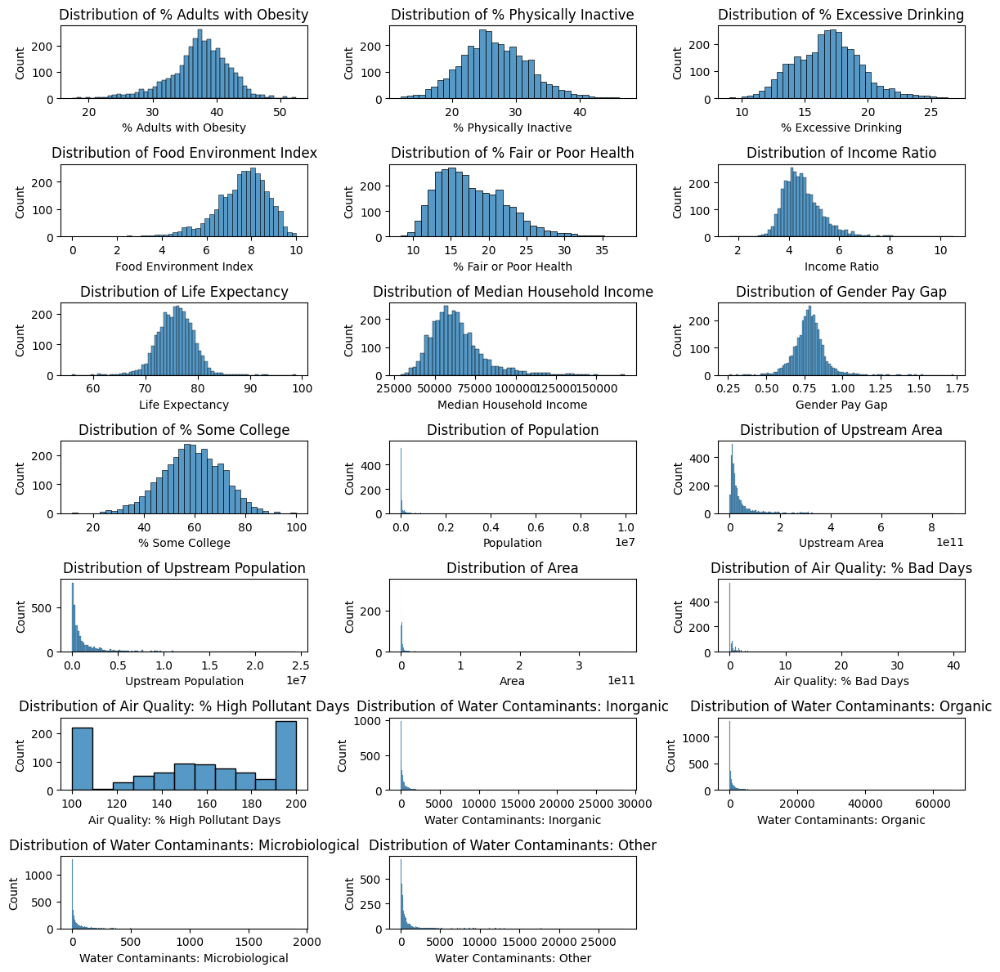

In [9]:
cols = [ '% Adults with Obesity','% Physically Inactive', '% Excessive Drinking',
       'Food Environment Index', '% Fair or Poor Health', 'Income Ratio',
       'Life Expectancy', 'Median Household Income', 'Gender Pay Gap',
       '% Some College', 'Population', 'Upstream Area', 'Upstream Population',
       'Area', 'Air Quality: % Bad Days','Air Quality: % High Pollutant Days', 
       'Water Contaminants: Inorganic','Water Contaminants: Organic', 'Water Contaminants: Microbiological',
       'Water Contaminants: Other']

fig, axes = plt.subplots(nrows= len(cols) // 3 + (len(cols) % 3 > 0), ncols=3, figsize=(12, 12))
axes = axes.flatten()  # Flatten the 2D array of axes for easy iteration

for i, col in enumerate(cols):
    sns.histplot(data=df, x=col, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

# Hide unused subplots if the number of columns isn't a perfect multiple of 3
for j in range(len(cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


Looking at these distributions, several variables could benefit from transformations to make them more suitable for ML modeling:

1. Median Household Income shows a right-skewed distribution with a long tail. Good candidate for:
   - Log transformation to normalize the distribution
   - Min-max or standard scaling if using algorithms sensitive to scale

2. Income Ratio also shows some right skew, though less extreme. Good candidate for:
   - Log transformation
   - Standard scaling

3. Population appears to be very unevenly distributed with most values concentrated in a small range. Good candidate for:
   - Log transformation to handle the large range of values
   - Possibly binning into categories if the exact population values aren't crucial

4. Gender Pay Gap appears to be centered around 0.8-0.9 but with some outliers. Good candidate for:
   - Standard scaling
   - Possibly winsorizing extreme outliers if they're determined to be anomalous

The other variables (obesity rates, physical inactivity, excessive drinking, food environment index, fair/poor health, life expectancy, some college) appear to be relatively normally distributed or at least not severely skewed.

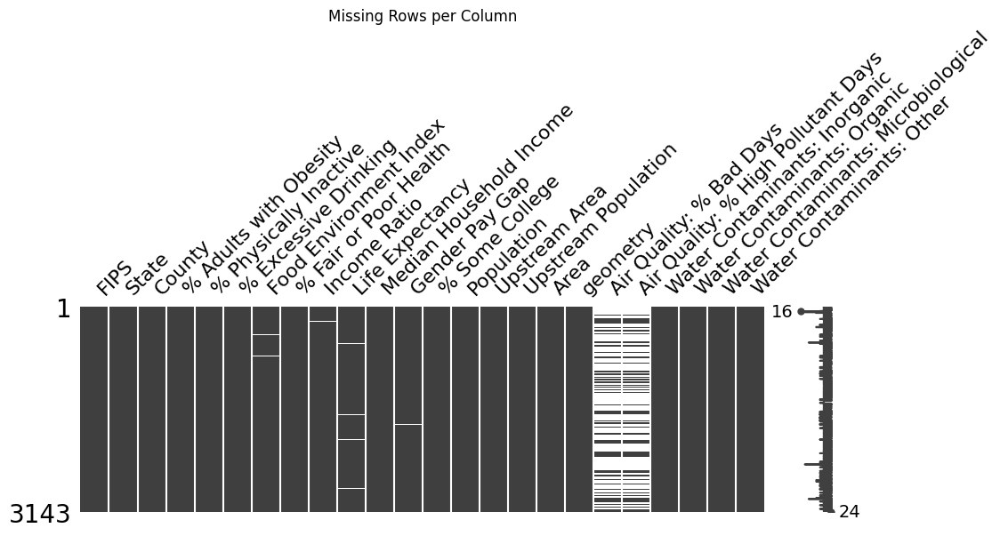

In [14]:
import missingno as msno
msno.matrix(df, figsize=(11,3), sparkline=True)
plt.title('Missing Rows per Column')
plt.show()

**Filling Missing data by KNN imputation**

There are few missing rows on all columns except for the Air Quality one, so we'll use impute to fill these missing values

In [15]:
# Importing modules from fancyimpute
from fancyimpute import KNN

columns_to_impute = ['Life Expectancy', 'Food Environment Index', '% Fair or Poor Health', "Gender Pay Gap", "Income Ratio"]
df_imputed = df.copy()

# Using KNN from fancyimpute to impute missing values
# fancyimpute requires input data to be a numpy array, so we'll convert it first
numerical_data = df[columns_to_impute].to_numpy()

# Applying KNN imputation
fancy_imputer = KNN(k=5, verbose=False)
imputed_data = fancy_imputer.fit_transform(numerical_data)

# Updating the dataframe with imputed values
df[columns_to_impute] = imputed_data

## 3.2 Creating a custom NeuralNet

In [16]:
# Written with help from Claude
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader

'''
-4 main layers (256→128→64→1 neurons)
-Batch normalization and dropout between layers to prevent overfitting
-AdamW optimizer with learning rate scheduling
-HuberLoss for handling outliers
'''

class WideNet(nn.Module):
    def __init__(self, input_dim):
        super().__init__()
        self.layers = nn.Sequential(
            nn.BatchNorm1d(input_dim),
            nn.Linear(input_dim, 256),
            nn.ReLU(),
            nn.BatchNorm1d(256),
            nn.Dropout(0.3),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.BatchNorm1d(128),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )    
    def forward(self, x):
        return self.layers(x)

'''
The layer structure (256→128→64→1) follows a funnel principle:

Starts wide (256) to capture complex patterns
Gradually narrows to prevent overfitting
Each subsequent layer halves the neurons (256→128→64)
Final layer (1) outputs the single target value (life expectancy)

BatchNorm and dropout between layers act as regulators, ensuring stable training and preventing overreliance on any specific features.
'''

class TabularNeuralNet:
    def __init__(self, input_dim, epochs=150):
        self.model = WideNet(input_dim)
        self.epochs = epochs
    
    def fit(self, X, y):
        X = torch.FloatTensor(X.values)
        y = torch.FloatTensor(y.values).reshape(-1, 1)
        
        mask = ~torch.isnan(X).any(dim=1)
        X = X[mask]
        y = y[mask]
        
        dataset = TensorDataset(X, y)
        train_loader = DataLoader(dataset, batch_size=64, shuffle=True)
        
        optimizer = torch.optim.AdamW(self.model.parameters(), lr=0.001, weight_decay=0.01)
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)
        criterion = nn.HuberLoss()
        
        for epoch in range(self.epochs):
            epoch_loss = 0
            for X_batch, y_batch in train_loader:
                optimizer.zero_grad()
                y_pred = self.model(X_batch)
                loss = criterion(y_pred, y_batch)
                loss.backward()
                optimizer.step()
                epoch_loss += loss.item()
            
            scheduler.step(epoch_loss)
                
        return self
    
    def predict(self, X):
        self.model.eval()
        with torch.no_grad():
            X = torch.FloatTensor(X.values)
            return self.model(X).numpy().reshape(-1)


## 3.3 Training and evaluating models

## 3.3.1 Using Life Expectancy as a target

**Scaling Features and creating feature interactions**

In [20]:
# Functions for scaling
def scale_features(df, columns_to_scale=None):
    """
    Scale specified columns or apply default scaling to all numeric columns
    if none are specified.
    """
    df_out = df.copy()
    
    # If columns_to_scale is None, we do default transformations
    if columns_to_scale is None:
        # 1) Columns typically long-tailed or heavily skewed: log + standard scale
        log_scale_cols = [
            'Population', 'Upstream Population', 'Area', 'Upstream Area',
            'Water Contaminants: Inorganic', 'Water Contaminants: Organic',
            'Water Contaminants: Microbiological', 'Water Contaminants: Other'
        ]
        
        # 2) Columns with a bounded range or near 0-100: min-max scaling
        minmax_scale_cols = [
            '% Adults with Obesity', '% Physically Inactive', '% Excessive Drinking',
            '% Fair or Poor Health', 'Air Quality: % High Pollutant Days', 'Air Quality: % Bad Days'
        ]
        
        # 3) Columns possibly containing outliers (broad range): robust scaling
        robust_scale_cols = [
            'Median Household Income', 'Income Ratio', 'Gender Pay Gap'
        ]
        
        # 4) Columns closer to normal or moderate skew: standard scaling
        standard_scale_cols = [
            'Life Expectancy', 'Food Environment Index', '% Some College'
        ]
        
        # 1) Log-transform + standard scale
        for col in log_scale_cols:
            if col in df_out.columns:
                # Replace zero or near-zero to avoid log(0)
                df_out[col] = np.log(df_out[col].replace(0, 1e-10))
                df_out[col] = StandardScaler().fit_transform(
                    df_out[col].values.reshape(-1, 1)
                ).ravel()
        
        # 2) Min-max scale
        mm_scaler = MinMaxScaler()
        for col in minmax_scale_cols:
            if col in df_out.columns:
                df_out[col] = mm_scaler.fit_transform(
                    df_out[col].values.reshape(-1, 1)
                ).ravel()
        
        # 3) Robust scale
        rb_scaler = RobustScaler()
        for col in robust_scale_cols:
            if col in df_out.columns:
                df_out[col] = rb_scaler.fit_transform(
                    df_out[col].values.reshape(-1, 1)
                ).ravel()
        
        # 4) Standard scale
        st_scaler = StandardScaler()
        for col in standard_scale_cols:
            if col in df_out.columns:
                df_out[col] = st_scaler.fit_transform(
                    df_out[col].values.reshape(-1, 1)
                ).ravel()
    
    else:
        # If columns_to_scale are specified (e.g. interaction columns),
        # apply standard scaling to those new columns by default.
        st_scaler = StandardScaler()
        for col in columns_to_scale:
            if col in df_out.columns:
                df_out[col] = st_scaler.fit_transform(
                    df_out[col].values.reshape(-1, 1)
                ).ravel()
    
    return df_out


def add_interactions(df, return_columns=False):
    """Add interaction features to a DataFrame. Optionally return the new columns for further scaling."""
    df_out = df.copy()
    
    new_columns = []
    for new_col, (col1, col2, operation) in interactions.items():
        if col1 in df_out.columns and col2 in df_out.columns:
            if operation == 'multiply':
                df_out[new_col] = df_out[col1] * df_out[col2]
            else:  # assume 'divide'
                # Again, to avoid division by zero
                df_out[new_col] = df_out[col1] / df_out[col2].replace(0, 1e-10)
            new_columns.append(new_col)
    
    if return_columns:
        return df_out, new_columns
    return df_out


In [23]:
interactions = {
        'Population Density': ('Population', 'Area', 'divide'),
        'Obesity * Inactivity': ('% Adults with Obesity', '% Physically Inactive', 'multiply'),
        'Obesity * Food Index': ('% Adults with Obesity', 'Food Environment Index', 'multiply'),
        #'Life Expectancy * Food Index': ('Life Expectancy', 'Food Environment Index', 'multiply'),
        #'Life Expectancy * Inactivity': ('Life Expectancy', '% Physically Inactive', 'multiply'),
        'Income * Education': ('Median Household Income', '% Some College', 'multiply'),
        'Income * Food Index': ('Median Household Income', 'Food Environment Index', 'multiply'),
        'Population * Education': ('Population', '% Some College', 'multiply'),
        'Alchoholism / Food Index': ('% Excessive Drinking', 'Food Environment Index', 'multiply'),
        'Income * Obesity': ('Median Household Income', '% Adults with Obesity', 'multiply'),
        'Food Index * Poor Health': ('Food Environment Index', '% Fair or Poor Health', 'multiply'),
        'Polluted Days * Population': ('Air Quality: % High Pollutant Days', 'Population', 'multiply')
    }

# 1) Unscaled DF with interaction features
df_ml_life = df.copy()
df_ml_life = add_interactions(df_ml_life)

# 2) Scaled DF with scaled interaction features
df_scaled = scale_features(df)
df_with_interactions, new_cols = add_interactions(df_scaled, return_columns=True)
df_ml_life_scaled = scale_features(df_with_interactions, columns_to_scale=new_cols)


Scaled dataset

In [24]:
# Features and target
X = df_ml_life_scaled.drop(['FIPS', 'State', 'County', 'geometry', 'Life Expectancy'], axis=1)
y = df_ml_life_scaled['Life Expectancy']

# Handle missing values
X = X.dropna(axis=1, how='all')  # Remove empty columns
df_ml_life_scaled_clean = X.join(y).dropna()
X_clean = df_ml_life_scaled_clean.drop(['Life Expectancy'], axis=1)
X_clean.columns = X_clean.columns.str.replace(' ', '_')
X_clean.columns = X_clean.columns.str.replace(r'[^a-zA-Z0-9_]', '', regex=True)  # Remove special characters for LightGBM
y_clean = df_ml_life_scaled_clean['Life Expectancy']

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X_clean, y_clean, test_size=0.2, random_state=42
)

# Initialize models with regularization to prevent overfitting
models_scaled = {
   "Linear Regression": LinearRegression(),
   "Ridge": Ridge(alpha=0.5),
   "SVR_rbf": SVR(kernel='rbf'),
   'ElasticNet': ElasticNet(alpha=0.1, l1_ratio=0.5),
   'KNN': KNeighborsRegressor(n_neighbors=5),
   "Random Forest": RandomForestRegressor(n_estimators=100, max_depth=5, random_state=42),
   "Extra Trees": ExtraTreesRegressor(n_estimators=100, max_depth=5, random_state=42),
   "Gradient Boosting": GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42),
   "XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42),
   "LightGBM": LGBMRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42, verbosity=-1),
   "Multi-Layer Perceptron": MLPRegressor(hidden_layer_sizes=(100,50), max_iter=1000, random_state=42),
   'Tabular NeuralNet': TabularNeuralNet(input_dim=X_train.shape[1])
}

def evaluate_model(model, X_train, X_test, y_train, y_test):
   # K-Fold Cross-validation
   kf = KFold(n_splits=5, shuffle=True, random_state=42)
   cv_scores = []
   
   for train_idx, val_idx in kf.split(X_train):
       X_fold_train, X_fold_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
       y_fold_train, y_fold_val = y_train.iloc[train_idx], y_train.iloc[val_idx]
       
       model.fit(X_fold_train, y_fold_train)
       y_fold_pred = model.predict(X_fold_val)
       cv_scores.append(np.sqrt(mean_squared_error(y_fold_val, y_fold_pred)))
   
   # Final training and prediction
   model.fit(X_train, y_train)
   y_pred = model.predict(X_test)
   
   return {
       "Model": type(model).__name__,
       "CV RMSE": np.mean(cv_scores),
       "CV Std": np.std(cv_scores),
       "Test MAE": mean_absolute_error(y_test, y_pred),
       "Test RMSE": np.sqrt(mean_squared_error(y_test, y_pred)),
       "R²": r2_score(y_test, y_pred)
   }

# Evaluate all models
results = []
for name, model in models_scaled.items():
    results.append(evaluate_model(model, X_train, X_test, y_train, y_test))

results_df = pd.DataFrame(results)
print("Model Performance Comparison:")
print(results_df.sort_values(by='Test RMSE'))
print()
print("Best Model: " + results_df.sort_values(by='Test RMSE').iloc[0]["Model"])

Model Performance Comparison:
                        Model  CV RMSE  CV Std  Test MAE  Test RMSE      R²
2                         SVR  0.56424 0.06227   0.39444    0.64767 0.56301
9               LGBMRegressor  0.51500 0.04882   0.38090    0.65799 0.54897
5       RandomForestRegressor  0.52023 0.03645   0.39031    0.66907 0.53365
8                XGBRegressor  0.51710 0.04955   0.38946    0.67114 0.53077
7   GradientBoostingRegressor  0.51577 0.04371   0.38638    0.67211 0.52941
6         ExtraTreesRegressor  0.51261 0.04483   0.38196    0.68116 0.51665
11           TabularNeuralNet  0.20777 0.15786   0.39199    0.68299 0.51405
1                       Ridge  0.53681 0.05944   0.40350    0.69009 0.50388
0            LinearRegression  0.53995 0.06265   0.40314    0.69027 0.50364
3                  ElasticNet  0.54764 0.05214   0.40939    0.70020 0.48925
4         KNeighborsRegressor  0.59778 0.05577   0.42282    0.72436 0.45339
10               MLPRegressor  0.64653 0.06392   0.52455  

Unscaled dataset

Below, we'll run Tree-based models on unscaled data.

In [25]:
# Features and target
X = df_ml_life.drop(['FIPS', 'State', 'County', 'geometry', 'Life Expectancy'], axis=1)
y = df_ml_life['Life Expectancy']

# Handle missing values
df_ml_life_clean = X.join(y)
X_clean = df_ml_life_clean.drop(['Life Expectancy'], axis=1)
X_clean.columns = X_clean.columns.str.replace(' ', '_')
X_clean.columns = X_clean.columns.str.replace(r'[^a-zA-Z0-9_]', '', regex=True)
y_clean = df_ml_life_clean['Life Expectancy']

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X_clean, y_clean, test_size=0.2, random_state=42
)

# Initialize models with regularization to prevent overfitting
models_unscaled = {
   "Random Forest": RandomForestRegressor(n_estimators=100, max_depth=5, random_state=42),
   "Extra Trees": ExtraTreesRegressor(n_estimators=100, max_depth=5, random_state=42),
   "XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42),
   "LightGBM": LGBMRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42, verbosity=-1)
   }

# Evaluate all models
results = []
for name, model in models_unscaled.items():
    results.append(evaluate_model(model, X_train, X_test, y_train, y_test))

results_df = pd.DataFrame(results)
print("Model Performance Comparison:")
print(results_df.sort_values(by='Test RMSE'))
print()
print("Best Model: " + results_df.sort_values(by='Test RMSE').iloc[0]["Model"])

Model Performance Comparison:
                   Model  CV RMSE  CV Std  Test MAE  Test RMSE      R²
2           XGBRegressor  1.96179 0.12609   1.42159    1.97488 0.66573
3          LGBMRegressor  1.97000 0.11822   1.42209    1.97673 0.66511
1    ExtraTreesRegressor  2.01561 0.15712   1.42473    1.97966 0.66411
0  RandomForestRegressor  2.01514 0.12149   1.44989    2.04288 0.64232

Best Model: XGBRegressor


Using Life Expectancy as a target, unscaled data had better results, with a maximum R² of 0.66

## 3.3.2 Using % Adults with Obesity as a target

Scaling Features and creating feature interactions

In [26]:
interactions = {
        'Population Density': ('Population', 'Area', 'divide'),
        #'Obesity * Inactivity': ('% Adults with Obesity', '% Physically Inactive', 'multiply'),
        #'Obesity * Food Index': ('% Adults with Obesity', 'Food Environment Index', 'multiply'),
        #'Income * Obesity': ('Median Household Income', '% Adults with Obesity', 'multiply'),
        'Life Expectancy * Food Index': ('Life Expectancy', 'Food Environment Index', 'multiply'),
        'Life Expectancy * Inactivity': ('Life Expectancy', '% Physically Inactive', 'multiply'),
        'Life Expectancy * Income': ('Life Expectancy', 'Median Household Income', 'multiply'),
        'Income * Education': ('Median Household Income', '% Some College', 'multiply'),
        'Income * Food Index': ('Median Household Income', 'Food Environment Index', 'multiply'),
        'Population * Education': ('Population', '% Some College', 'multiply'),
        'Alchoholism / Food Index': ('% Excessive Drinking', 'Food Environment Index', 'multiply'),
        'Food Index * Poor Health': ('Food Environment Index', '% Fair or Poor Health', 'multiply'),
        'Polluted Days * Population': ('Air Quality: % High Pollutant Days', 'Population', 'multiply')
    }

# 1) Unscaled DF with interaction features
df_ml_obesity = df.copy()
df_ml_obesity = add_interactions(df_ml_obesity)

# 2) Scaled DF with scaled interaction features
df_scaled = scale_features(df)
df_with_interactions, new_cols = add_interactions(df_scaled, return_columns=True)
df_ml_obesity_scaled = scale_features(df_with_interactions, columns_to_scale=new_cols)


Scaled dataset

In [27]:
# Features and target
X = df_ml_obesity_scaled.drop(['FIPS', 'State', 'County', 'geometry', '% Adults with Obesity'], axis=1)
y = df_ml_obesity_scaled['% Adults with Obesity']

# Handle missing values
X = X.dropna(axis=1, how='all')  # Remove empty columns
df_ml_obesity_scaled_clean = X.join(y).dropna()
X_clean = df_ml_obesity_scaled_clean.drop(['% Adults with Obesity'], axis=1)
X_clean.columns = X_clean.columns.str.replace(' ', '_')
X_clean.columns = X_clean.columns.str.replace(r'[^a-zA-Z0-9_]', '', regex=True)  # Remove special characters for LightGBM
y_clean = df_ml_obesity_scaled_clean['% Adults with Obesity']

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X_clean, y_clean, test_size=0.2, random_state=42
)

# Evaluate all models
results = []
for name, model in models_scaled.items():
    results.append(evaluate_model(model, X_train, X_test, y_train, y_test))

results_df = pd.DataFrame(results)
print("Model Performance Comparison:")
print(results_df.sort_values(by='Test RMSE'))
print()
print("Best Model: " + results_df.sort_values(by='Test RMSE').iloc[0]["Model"])

Model Performance Comparison:
                        Model  CV RMSE  CV Std  Test MAE  Test RMSE      R²
7   GradientBoostingRegressor  0.07868 0.00453   0.05993    0.07337 0.69138
8                XGBRegressor  0.07878 0.00454   0.06033    0.07363 0.68922
9               LGBMRegressor  0.07851 0.00330   0.06018    0.07372 0.68843
5       RandomForestRegressor  0.08127 0.00430   0.06460    0.07813 0.64999
6         ExtraTreesRegressor  0.08288 0.00428   0.06703    0.08203 0.61419
0            LinearRegression  0.08400 0.00490   0.06954    0.08728 0.56323
1                       Ridge  0.08374 0.00548   0.06985    0.08803 0.55567
2                         SVR  0.09241 0.00570   0.07195    0.09129 0.52222
11           TabularNeuralNet  0.06071 0.03689   0.07273    0.09145 0.52055
4         KNeighborsRegressor  0.09672 0.00573   0.07632    0.09191 0.51569
3                  ElasticNet  0.11344 0.00424   0.08978    0.11031 0.30234
10               MLPRegressor  0.12827 0.03006   0.08906  

Unscaled dataset

In [28]:
# Features and target
X = df_ml_obesity.drop(['FIPS', 'State', 'County', 'geometry', '% Adults with Obesity'], axis=1)
y = df_ml_obesity['% Adults with Obesity']

# Handle missing values
df_ml_obesity_clean = X.join(y)
X_clean = df_ml_obesity_clean.drop(['% Adults with Obesity'], axis=1)
X_clean.columns = X_clean.columns.str.replace(' ', '_')
X_clean.columns = X_clean.columns.str.replace(r'[^a-zA-Z0-9_]', '', regex=True)
y_clean = df_ml_obesity_clean['% Adults with Obesity']

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X_clean, y_clean, test_size=0.2, random_state=42
)

# Evaluate all models
results = []
for name, model in models_unscaled.items():
    results.append(evaluate_model(model, X_train, X_test, y_train, y_test))

results_df = pd.DataFrame(results)
print("Model Performance Comparison:")
print(results_df.sort_values(by='Test RMSE'))
print()
print("Best Model: " + results_df.sort_values(by='Test RMSE').iloc[0]["Model"])

Model Performance Comparison:
                   Model  CV RMSE  CV Std  Test MAE  Test RMSE      R²
3          LGBMRegressor  2.40914 0.07338   1.89645    2.41368 0.71797
2           XGBRegressor  2.40728 0.07310   1.89648    2.41898 0.71673
0  RandomForestRegressor  2.53746 0.05935   2.01609    2.56007 0.68272
1    ExtraTreesRegressor  2.59486 0.06193   2.08461    2.64029 0.66252

Best Model: LGBMRegressor


Using Obesity as a target, leads a higher R² of 0.717. We'll use this target in the following sections.

## 3.4 Hyperparameter Tuning

Performance using Tree-based models on unscaled data is superior.

Below, LGBM will be tuned using Bayesian Optimization

In [30]:
# Bayesian Optimization for LGBM
def optimize_lgb(X_train, y_train, X_test, y_test, random_state=42):
    # Define the parameter space
    param_space = {
        'n_estimators': Integer(100, 1000),
        'max_depth': Integer(3, 10),
        'learning_rate': Real(0.01, 0.3, prior='log-uniform'),
        'subsample': Real(0.5, 1.0),
        'colsample_bytree': Real(0.5, 1.0),
        'min_child_weight': Integer(1, 7),
        'gamma': Real(0, 5),
        'reg_alpha': Real(0.001, 10, prior='log-uniform'),
        'reg_lambda': Real(0.001, 10, prior='log-uniform')
    }

    # Create base model
    base_model = XGBRegressor(
        objective='reg:squarederror',
        n_jobs=-1,
        random_state=random_state,
        verbosity=0
    )

    # Define cross-validation strategy
    cv = KFold(
        n_splits=5,
        shuffle=True,
        random_state=random_state
    )

    # Create BayesSearchCV object
    opt = BayesSearchCV(
        base_model,
        param_space,
        n_iter=50,  # Number of optimization iterations
        cv=cv,
        n_jobs=-1,
        scoring='neg_root_mean_squared_error',
        random_state=random_state,
        verbose=0
    )

    # Fit the optimizer
    opt.fit(X_train, y_train)

    # Get the best parameters and score
    best_params = opt.best_params_
    best_score = -opt.best_score_  # Convert back to positive RMSE

    # Train final model with best parameters
    final_model = XGBRegressor(
        **best_params,
        objective='reg:squarederror',
        n_jobs=-1,
        random_state=random_state,
        verbosity=0
    )

    # Evaluate on both train and test sets
    final_model.fit(X_train, y_train)
    
    # Cross-validation score on training data
    cv_scores = cross_val_score(
        final_model, 
        X_train, 
        y_train, 
        cv=cv, 
        scoring='neg_root_mean_squared_error',
        n_jobs=-1
    )
    
    # Test set predictions
    y_pred = final_model.predict(X_test)
    test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    test_r2 = r2_score(y_test, y_pred)

    results = {
        'best_parameters': best_params,
        'cv_rmse_mean': -np.mean(cv_scores),
        'cv_rmse_std': np.std(cv_scores),
        'test_rmse': test_rmse,
        'test_r2': test_r2,
        'model': final_model,
        'optimization_history': {
            'iteration': range(len(opt.cv_results_['mean_test_score'])),
            'mean_test_score': -np.array(opt.cv_results_['mean_test_score']),
            'std_test_score': np.array(opt.cv_results_['std_test_score'])
        }
    }

    return results



Best Parameters:
colsample_bytree: 0.7871173693822686
gamma: 4.2795562427042535
learning_rate: 0.022788147084706903
max_depth: 5
min_child_weight: 3
n_estimators: 351
reg_alpha: 0.001
reg_lambda: 0.001
subsample: 0.5

Cross-validation RMSE: 2.3548 (+/- 0.0552)
Test RMSE: 2.3703
Test R²: 0.7280


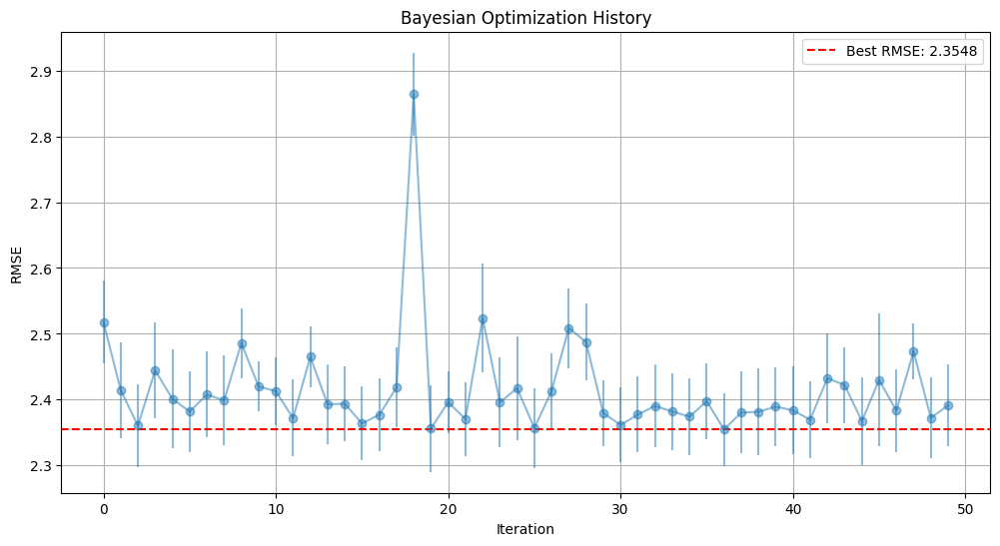

In [ ]:
results = optimize_lgb(X_train, y_train, X_test, y_test)

print("\nBest Parameters:")
for param, value in results['best_parameters'].items():
    print(f"{param}: {value}")

print(f"\nCross-validation RMSE: {results['cv_rmse_mean']:.4f} (+/- {results['cv_rmse_std']:.4f})")
print(f"Test RMSE: {results['test_rmse']:.4f}")
print(f"Test R²: {results['test_r2']:.4f}")

## 3.5 SHAP and Feature Importance Analysis

In [ ]:
# Analyzing feature importance
from sklearn.feature_selection import RFECV

def analyze_feature_impact(X_test, y_test, model):
   impacts = {}
   for feature in X_test.columns:
       X_varied = X_test.copy()
       X_varied[feature] *= 1.1
       pred_varied = model.predict(X_varied)
       pred_original = model.predict(X_test)
       impact = np.mean(pred_varied - pred_original)
       impacts[feature] = impact
   
   # Sort and display results
   impacts_df = pd.DataFrame({'Feature': impacts.keys(), 'Impact': impacts.values()})
   return impacts_df.sort_values('Impact', ascending=False)

# For Extra Trees
selector = RFECV(XGBRegressor(), 
                 cv=5,
                 scoring='neg_mean_squared_error',
                 min_features_to_select=10)
selector.fit(X_train, y_train)
selected_features = X.columns[selector.support_]

# Usage
XGBoost = XGBRegressor()
XGBoost.fit(X_train, y_train)
XGBoost_feature_impacts = analyze_feature_impact(X_test, y_test, XGBoost)
print(XGBoost_feature_impacts)

                               Feature   Impact
0                 _Physically_Inactive  0.81414
3                 _Fair_or_Poor_Health  0.18927
27             Food_Index__Poor_Health  0.06838
2               Food_Environment_Index  0.05751
1                  _Excessive_Drinking  0.05463
26             Alchoholism__Food_Index  0.04187
15        Water_Contaminants_Inorganic  0.01585
21         Life_Expectancy__Inactivity  0.01422
28           Polluted_Days__Population  0.00754
18            Water_Contaminants_Other  0.00513
10                       Upstream_Area  0.00462
12                                Area  0.00457
16          Water_Contaminants_Organic  0.00328
19                  Population_Density  0.00289
9                           Population  0.00023
13               Air_Quality__Bad_Days -0.00006
23                   Income__Education -0.00080
14    Air_Quality__High_Pollutant_Days -0.00227
11                 Upstream_Population -0.00366
17  Water_Contaminants_Microbiological -

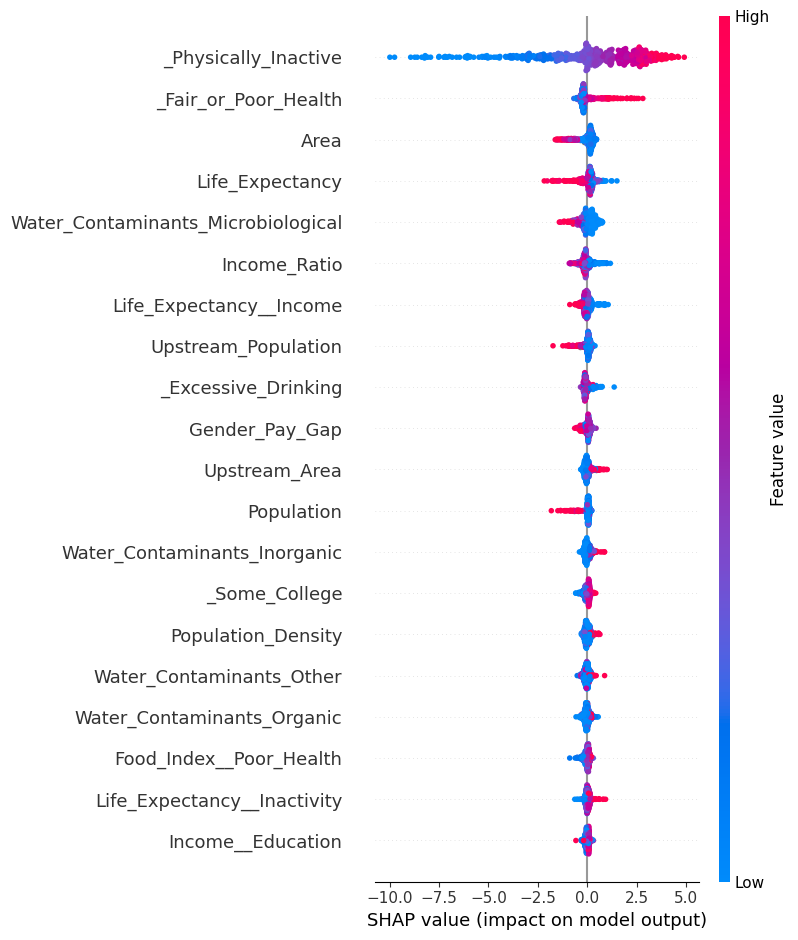

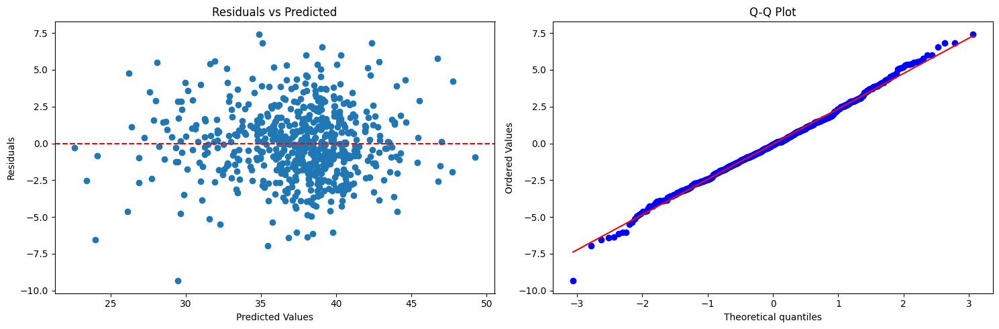

<Figure size 1500x500 with 0 Axes>

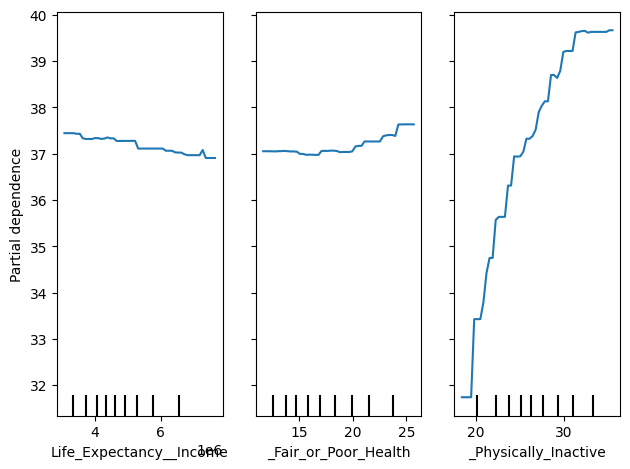

In [41]:
import shap
import matplotlib.pyplot as plt
from sklearn.inspection import PartialDependenceDisplay
from scipy import stats

def analyze_model(model, X_train, X_test, y_test, feature_names):
    # SHAP values
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X_test)
    
    plt.figure(figsize=(10, 6))
    shap.summary_plot(shap_values, X_test, feature_names=feature_names)
    
    # Residuals analysis
    y_pred = model.predict(X_test)
    residuals = y_test - y_pred
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
    # Residuals vs Predicted
    ax1.scatter(y_pred, residuals)
    ax1.axhline(y=0, color='r', linestyle='--')
    ax1.set_xlabel('Predicted Values')
    ax1.set_ylabel('Residuals')
    ax1.set_title('Residuals vs Predicted')
    
    # QQ Plot
    stats.probplot(residuals, dist="norm", plot=ax2)
    ax2.set_title('Q-Q Plot')
    plt.tight_layout()
    
    # Partial dependence for top features
    if hasattr(model, 'feature_importances_'):
        top_features = np.argsort(model.feature_importances_)[-3:]
        feature_names_top = [feature_names[i] for i in top_features]
        
        fig = plt.figure(figsize=(15, 5))
        PartialDependenceDisplay.from_estimator(
            model, 
            X_train, 
            features=feature_names_top,
            kind='average',
            subsample=1000,
            n_jobs=3,
            grid_resolution=50
        )
        plt.tight_layout()
    
    plt.show()

lgb_model = LGBMRegressor()
lgb_model.fit(X_train, y_train)

# Use for your best model(s)
analyze_model(lgb_model, X_train, X_test, y_test, X_train.columns)

1. **SHAP Value Plot**:
- The colors show whether high (red) or low (blue) feature values increase (positive SHAP value) or decrease (negative SHAP value) obesity rates
- Most important features:
  - Physical Inactivity has the strongest impact, with higher values (red) increasing obesity rates
  - Fair/Poor Health status is the second most important
  - Area of county is third most important, possibly indicating a correlation between larger, rural counties in opposition to denser, urban ones

2. **Residuals Plot**:
- Left plot (Residuals vs Predicted):
  - Shows a fairly random scatter around zero, which is good
  - Some heteroscedasticity (spread increases slightly with predicted values)
  - A few outliers with residuals < -7.5
- Right plot (Q-Q Plot):
  - Shows residuals follow a nearly normal distribution (points close to the diagonal line)
  - Some deviation at the extremes, especially in the lower tail

3. **Partial Dependence Plots**:
- Life_Expectancy_Income: Slight negative relationship
- Fair_or_Poor_Health: Positive relationship after a certain threshold (~24%)
- Physically_Inactive: Strong positive relationship (more physical inactivity → higher obesity rates)

## 4. Insights: 

1. Physical inactivity is the strongest predictor
2. The model's assumptions (normality, homoscedasticity) are reasonably met
3. While the relationships make intuitive sense (more physical inactivity and poor health correlate with higher obesity rates), they cannot be used to indicate causation.

**On Causality**
1. Correlation ≠ Causation:
- While physical inactivity strongly predicts obesity, it can't definitively be said it causes obesity, the relationship is most likely bidirectional.
- There could be unmeasured confounding variables

2. Limitations of the Model:
- The model only shows associations between variables
- It cannot distinguish between:
  - Direct causal effects
  - Reverse causation
  - Confounders
  - Spurious correlations

3. Complex Interrelationships:
- Health variables like physical inactivity, poor health, and obesity are complex and multifactorial
- Socioeconomic factors (income, education, population genetics) likely influence multiple variables simultaneously